# ETL

In [1]:
import PIL.Image as Image
import numpy as np
import cv2
import yolov5
import os
import time 

**Importing our trained Yolov5 Model**

In [2]:
import torch
import torchvision
from torchvision.io import read_image

lm = yolov5.load('best_updated.pt')


YOLOv5  2023-1-29 Python-3.8.13 torch-1.13.0+cpu CPU

Fusing layers... 
Model summary: 214 layers, 7027720 parameters, 0 gradients, 16.0 GFLOPs
Adding AutoShape... 


## **Using images for input**

In [3]:
# only one test video file
video_path = ""

# image test files
image_path = []
for i in os.listdir('test2'):
    if 'mp4' in os.path.join('test2', i):
        video_path = os.path.join('test2', i)
    else:
        image_path.append(os.path.join('test2', i))

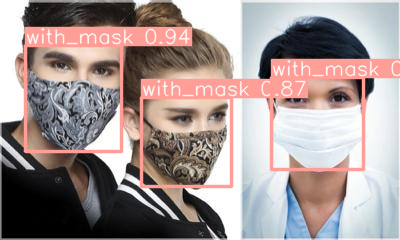

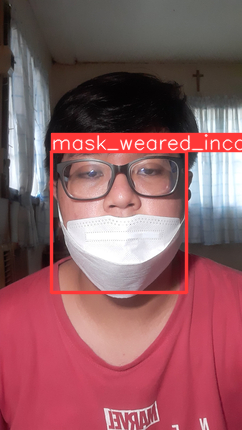

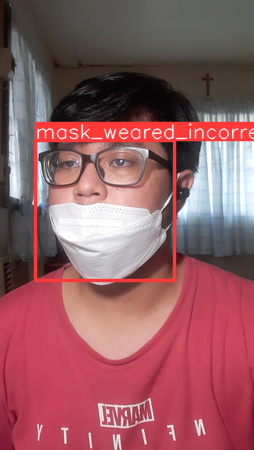

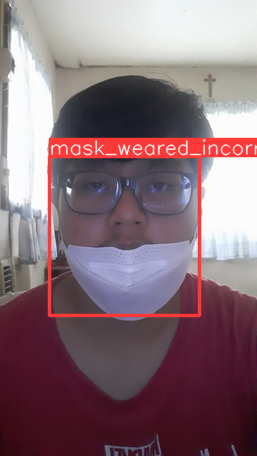

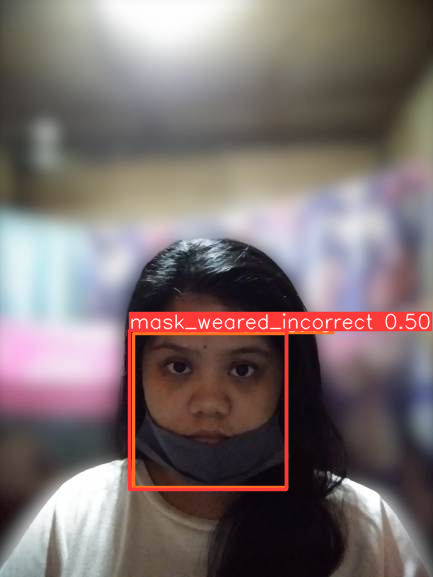

...

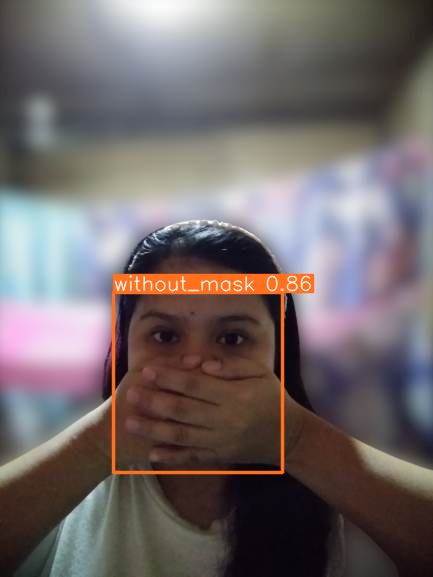

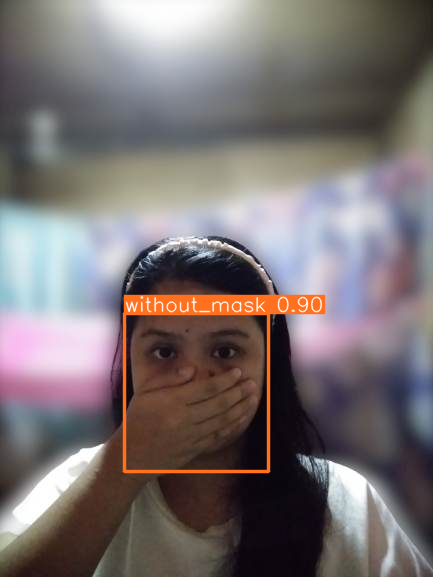

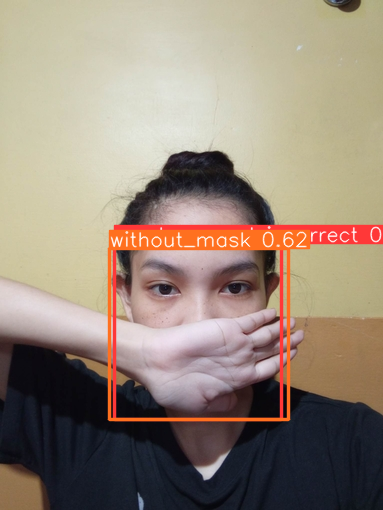

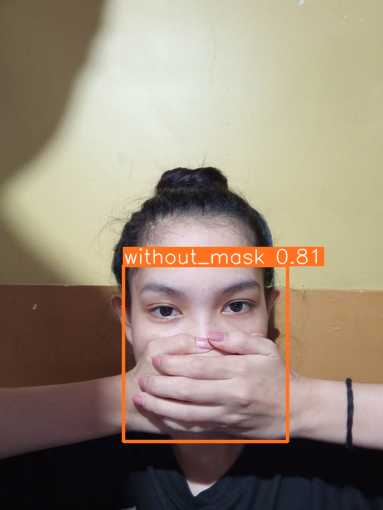

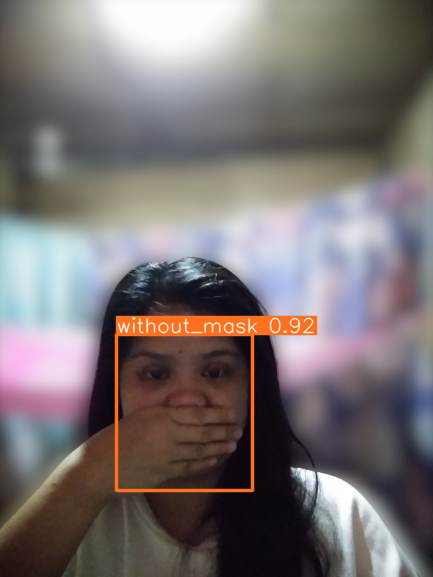

In [4]:
for i in image_path:
    t1 = lm(i)
    t1.show()

# Video or Real-Time as Input

In [14]:
class ObjectCam:
    def __init__(self):
       
        self.model = self.load_model()
        self.classes = self.model.names
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'
        print("\n\nDevice Used:",self.device)
        
    def load_model(self):
        """
        Loads Yolo5 model from pytorch hub.
        :return: Trained Pytorch model.
        """
        model = yolov5.load('best_updated.pt')
        return model


    def score_frame(self, frame):
        
        self.model.to(self.device)
        frame = [frame]
        results = self.model(frame)
     
        labels, cord = results.xyxyn[0][:, -1], results.xyxyn[0][:, :-1]
        return labels, cord


    def class_to_label(self, x):
       
        return self.classes[int(x)]


    def plot_boxes(self, results, frame):
        
        labels, cord = results
        n = len(labels)
        x_shape, y_shape = frame.shape[1], frame.shape[0]
        for i in range(n):
            row = cord[i]
            score = row[4]
            if score >= 0.2:
                x1, y1, x2, y2 = int(row[0]*x_shape), int(row[1]*y_shape), int(row[2]*x_shape), int(row[3]*y_shape)
                label = self.class_to_label(labels[i])
                if label == 'with_mask':
                    bgr = (0, 255, 0)
                elif label == 'without_mask':
                    bgr = (0, 0, 255)
                elif label == 'mask_weared_incorrectly':
                    bgr = (255, 255, 0)
                else:
                    bgr = (0, 255, 255)
                cv2.rectangle(frame, (x1, y1), (x2, y2), bgr, 2)
                text = f"{label}: {score:.2f}"
                cv2.putText(frame, text, (x1, y1), cv2.FONT_HERSHEY_SIMPLEX, 0.9, bgr, 2)

        return frame




    def __call__(self):
       
        cap = cv2.VideoCapture(0)

        while cap.isOpened():
            
            start_time = time.perf_counter()
            ret, frame = cap.read()
            if not ret:
                break
            results = self.score_frame(frame)
            frame = self.plot_boxes(results, frame)
            end_time = time.process_time()
            fps = 1 / np.round(end_time - start_time, 3)
            cv2.putText(frame, f'FPS: {int(fps)}', (20,70), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0,255,0), 2)
            cv2.imshow("img", frame)

            if cv2.waitKey(1) & 0xFF == ord('q'):
                break
        # Release the video and close the window
        cap.release()
        cv2.destroyAllWindows()


In [17]:
detect = ObjectCam()
detect()

YOLOv5  2023-1-29 Python-3.8.13 torch-1.13.0+cpu CPU

Fusing layers... 
Model summary: 214 layers, 7027720 parameters, 0 gradients, 16.0 GFLOPs
Adding AutoShape... 




Device Used: cpu
